In [1]:
import torch
from torch import nn, optim
from torchsummary import summary
from torchvision.utils import make_grid

import os
from shutil import rmtree
import imageio
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


In [2]:
def pil_to_np_array(pil_image):
    array = np.array(pil_image).transpose(2,0,1)
    return array.astype(np.float32) / 255.

def np_to_torch_array(np_array):
    return torch.from_numpy(np_array)[None, :]

def torch_to_np_array(torch_array):
    return torch_array.detach().cpu().numpy()[0]

def read_image(path, image_size = -1):
    pil_image = Image.open(path)
    return pil_image

def save_image(np_array, step):
    pil_image = Image.fromarray((np_array * 255.0).transpose(1, 2, 0).astype('uint8'), 'RGB')
    pil_image.save(f'progress/{str(step).zfill(len(str(TRAINING_STEPS)))}.png')

def get_image_grid(images, nrow = 3):
    torch_images = [torch.from_numpy(x) for x in images]
    grid = make_grid(torch_images, nrow)
    return grid.numpy()
    
def visualize_sample(*images_np, nrow = 3, size_factor = 10):
    c = max(x.shape[0] for x in images_np)
    images_np = [x if (x.shape[0] == c) else np.concatenate([x, x, x], axis=0) for x in images_np]
    grid = get_image_grid(images_np, nrow)
    plt.figure(figsize = (len(images_np) + size_factor, 12 + size_factor))
    plt.axis('off')
    plt.imshow(grid.transpose(1, 2, 0))
    plt.show()

In [3]:
DTYPE = torch.cuda.FloatTensor
INPUT_DEPTH = 32
LR = 0.01 
TRAINING_STEPS = 10000
SHOW_STEP = 50
REG_NOISE = 0.03
MAX_DIM = 128

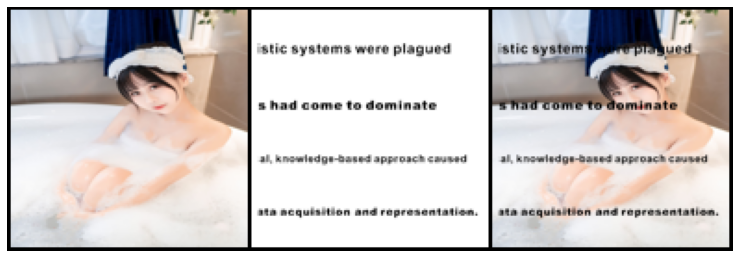

In [4]:
# original_image_path  = os.path.join('data/watermark-available/image1.png')
original_image_path  = 'D:/work/Stuff/image_data_set_1/Original/image_03999.jpg'
watermark_path = os.path.join('data/watermark-available/watermark.png')

original_image_pil = read_image(original_image_path)
original_image_pil = original_image_pil.convert('RGB')
original_image_pil = original_image_pil.resize((128, 128))

w, h = original_image_pil.size
aspect_ratio = w / h
if w > MAX_DIM and w > h:
    h = int((h / w) * MAX_DIM)
    w = MAX_DIM
elif h > MAX_DIM and h > w:
    w = int((w / h) * MAX_DIM)
    h = MAX_DIM

original_image_pil = original_image_pil.resize((w, h))

watermark_pil = read_image(watermark_path)
watermark_pil = watermark_pil.convert('RGB')
watermark_pil = watermark_pil.resize((original_image_pil.size[0], original_image_pil.size[1]))

original_image_np = pil_to_np_array(original_image_pil)
watermark_np = pil_to_np_array(watermark_pil)
# watermark_np[watermark_np == 0.0] = 1.0

watermarked_np = original_image_np * watermark_np
image_mask_var = np_to_torch_array(watermark_np).type(DTYPE)

visualize_sample(original_image_np, watermark_np, watermarked_np, nrow = 3, size_factor = 10)

In [5]:
class Conv2dBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride = 1, bias = False):
        super(Conv2dBlock, self).__init__()

        self.model = nn.Sequential(
            nn.ReflectionPad2d(int((kernel_size - 1) / 2)),
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding = 0, bias = bias),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.model(x)

class Concat(nn.Module):
    def __init__(self, dim, *args):
        super(Concat, self).__init__()
        self.dim = dim

        for idx, module in enumerate(args):
            self.add_module(str(idx), module)

    def forward(self, input):
        inputs = []
        for module in self._modules.values():
            inputs.append(module(input))

        inputs_shapes2 = [x.shape[2] for x in inputs]
        inputs_shapes3 = [x.shape[3] for x in inputs]        

        if np.all(np.array(inputs_shapes2) == min(inputs_shapes2)) and np.all(np.array(inputs_shapes3) == min(inputs_shapes3)):
            inputs_ = inputs
        else:
            target_shape2 = min(inputs_shapes2)
            target_shape3 = min(inputs_shapes3)

            inputs_ = []
            for inp in inputs: 
                diff2 = (inp.size(2) - target_shape2) // 2 
                diff3 = (inp.size(3) - target_shape3) // 2 
                inputs_.append(inp[:, :, diff2: diff2 + target_shape2, diff3:diff3 + target_shape3])

        return torch.cat(inputs_, dim=self.dim)

    def __len__(self):
        return len(self._modules)

In [6]:
class SkipEncoderDecoder(nn.Module):
    def __init__(self, input_depth, num_channels_down = [128] * 5, num_channels_up = [128] * 5, num_channels_skip = [128] * 5):
        super(SkipEncoderDecoder, self).__init__()

        self.model = nn.Sequential()
        model_tmp = self.model

        for i in range(len(num_channels_down)):

            deeper = nn.Sequential()
            skip = nn.Sequential()

            if num_channels_skip[i] != 0:
                model_tmp.add_module(str(len(model_tmp) + 1), Concat(1, skip, deeper))
            else:
                model_tmp.add_module(str(len(model_tmp) + 1), deeper)
            
            model_tmp.add_module(str(len(model_tmp) + 1), nn.BatchNorm2d(num_channels_skip[i] + (num_channels_up[i + 1] if i < (len(num_channels_down) - 1) else num_channels_down[i])))

            if num_channels_skip[i] != 0:
                skip.add_module(str(len(skip) + 1), Conv2dBlock(input_depth, num_channels_skip[i], 1, bias = False))
                
            deeper.add_module(str(len(deeper) + 1), Conv2dBlock(input_depth, num_channels_down[i], 3, 2, bias = False))
            deeper.add_module(str(len(deeper) + 1), Conv2dBlock(num_channels_down[i], num_channels_down[i], 3, bias = False))

            deeper_main = nn.Sequential()

            if i == len(num_channels_down) - 1:
                k = num_channels_down[i]
            else:
                deeper.add_module(str(len(deeper) + 1), deeper_main)
                k = num_channels_up[i + 1]

            deeper.add_module(str(len(deeper) + 1), nn.Upsample(scale_factor = 2, mode = 'nearest'))

            model_tmp.add_module(str(len(model_tmp) + 1), Conv2dBlock(num_channels_skip[i] + k, num_channels_up[i], 3, 1, bias = False))
            model_tmp.add_module(str(len(model_tmp) + 1), Conv2dBlock(num_channels_up[i], num_channels_up[i], 1, bias = False))

            input_depth = num_channels_down[i]
            model_tmp = deeper_main

        self.model.add_module(str(len(self.model) + 1), nn.Conv2d(num_channels_up[0], 3, 1, bias = True))
        self.model.add_module(str(len(self.model) + 1), nn.Sigmoid())
    
    def forward(self, x):
        return self.model(x)

def input_noise(input_depth, spatial_size, scale = 1.0/10):
    shape = [1, input_depth, spatial_size[0], spatial_size[1]]
    return torch.rand(*shape) * scale

In [7]:
generator = SkipEncoderDecoder(
    INPUT_DEPTH,
    num_channels_down = [128] * 5,
    num_channels_up = [128] * 5,
    num_channels_skip = [128] * 5
).type(DTYPE)
generator_input = input_noise(INPUT_DEPTH, watermarked_np.shape[1:]).type(DTYPE)
summary(generator, generator_input.shape[1:])

objective = torch.nn.MSELoss().type(DTYPE)
optimizer = optim.Adam(generator.parameters(), LR)

watermarked_var = np_to_torch_array(watermarked_np).type(DTYPE)
watermark_var = np_to_torch_array(watermark_np).type(DTYPE)

generator_input_saved = generator_input.detach().clone()
noise = generator_input.detach().clone()

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1         [-1, 32, 128, 128]               0
            Conv2d-2        [-1, 128, 128, 128]           4,096
       BatchNorm2d-3        [-1, 128, 128, 128]             256
         LeakyReLU-4        [-1, 128, 128, 128]               0
       Conv2dBlock-5        [-1, 128, 128, 128]               0
   ReflectionPad2d-6         [-1, 32, 130, 130]               0
            Conv2d-7          [-1, 128, 64, 64]          36,864
       BatchNorm2d-8          [-1, 128, 64, 64]             256
         LeakyReLU-9          [-1, 128, 64, 64]               0
      Conv2dBlock-10          [-1, 128, 64, 64]               0
  ReflectionPad2d-11          [-1, 128, 66, 66]               0
           Conv2d-12          [-1, 128, 64, 64]         147,456
      BatchNorm2d-13          [-1, 128, 64, 64]             256
        LeakyReLU-14          [-1, 128,

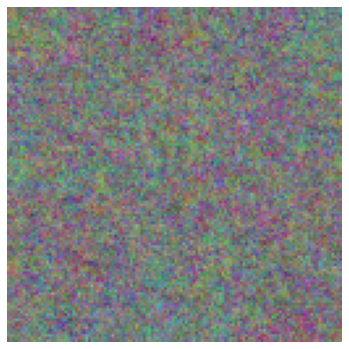

Step: 0 | Loss: 0.1407421976327896


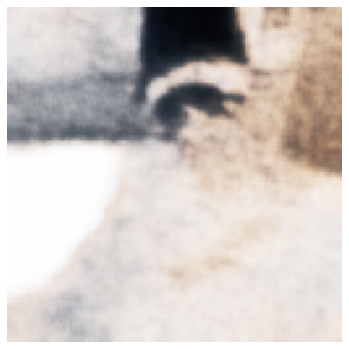

Step: 50 | Loss: 0.005360403563827276


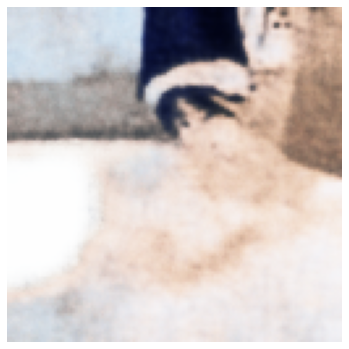

Step: 100 | Loss: 0.0023988913744688034


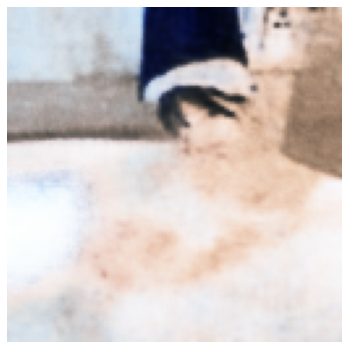

Step: 150 | Loss: 0.0016095619648694992


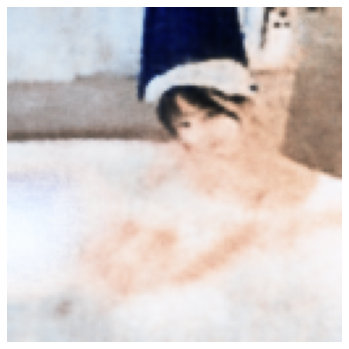

Step: 200 | Loss: 0.0010897875763475895


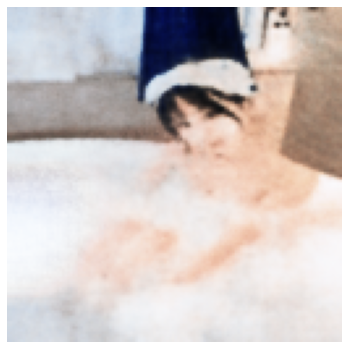

Step: 250 | Loss: 0.0008839149959385395


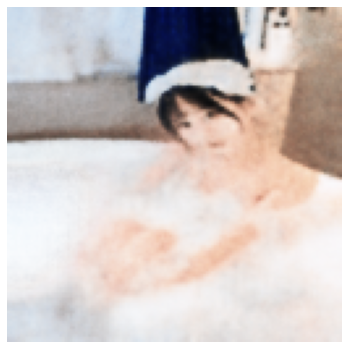

Step: 300 | Loss: 0.0007249179179780185


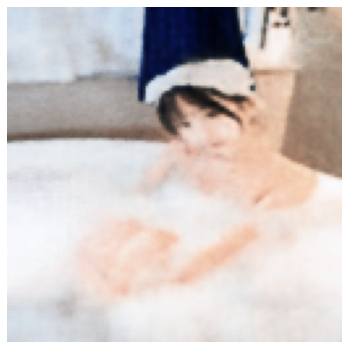

Step: 350 | Loss: 0.0006268497672863305


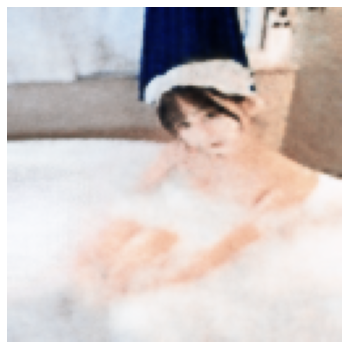

Step: 400 | Loss: 0.0005515557713806629


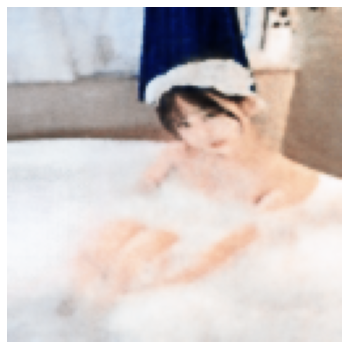

Step: 450 | Loss: 0.0004971821326762438


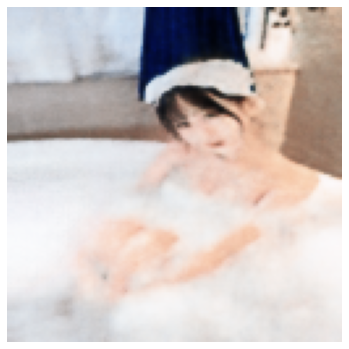

Step: 500 | Loss: 0.000401532364776358


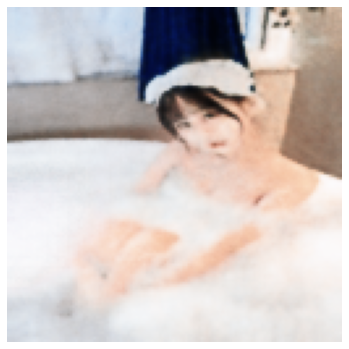

Step: 550 | Loss: 0.0003828743938356638


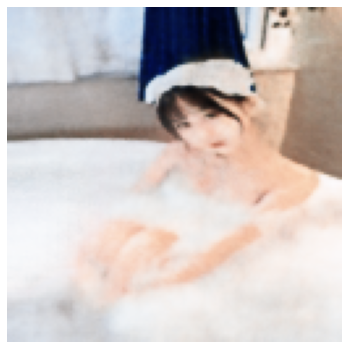

Step: 600 | Loss: 0.0003266689309384674


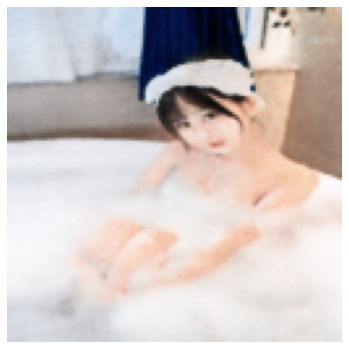

Step: 650 | Loss: 0.00031747572938911617


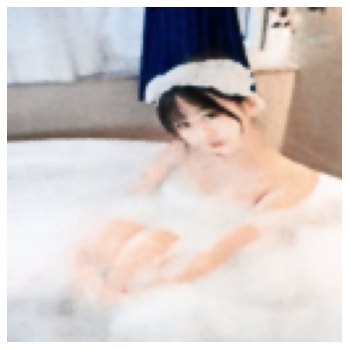

Step: 700 | Loss: 0.00029064094997011125


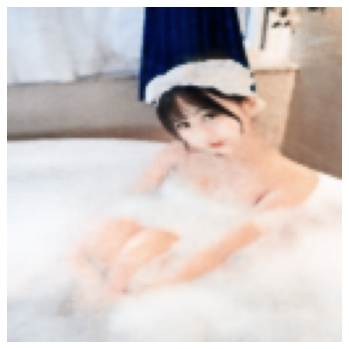

Step: 750 | Loss: 0.0002706174273043871


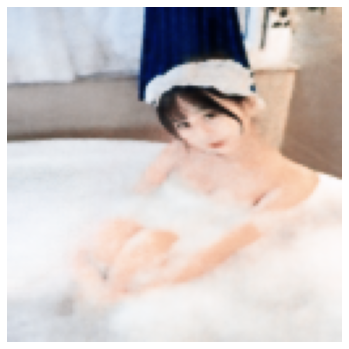

Step: 800 | Loss: 0.0002596286067273468


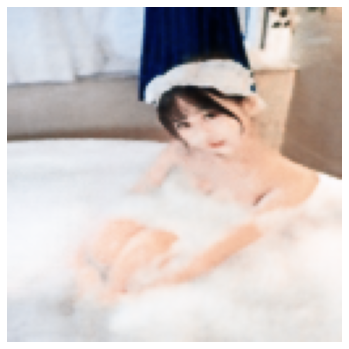

Step: 850 | Loss: 0.0002677200245670974


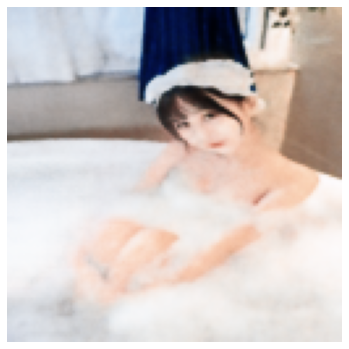

Step: 900 | Loss: 0.00021802954142913222


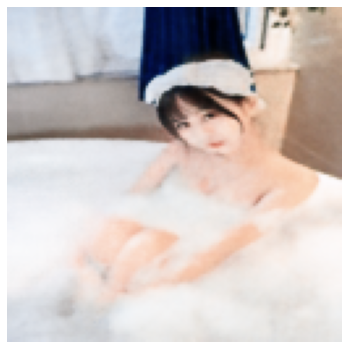

Step: 950 | Loss: 0.00020243340986780822


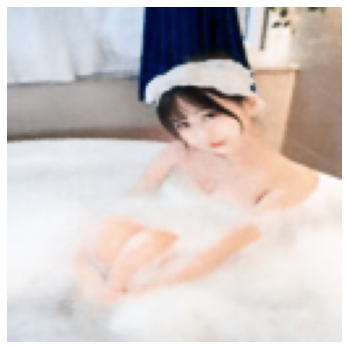

Step: 1000 | Loss: 0.00019343916210345924


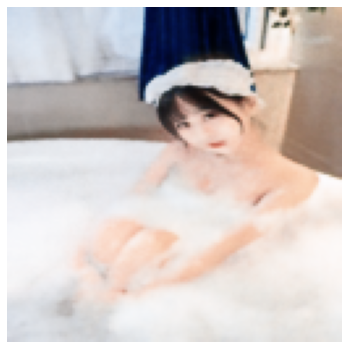

Step: 1050 | Loss: 0.0001802369370125234


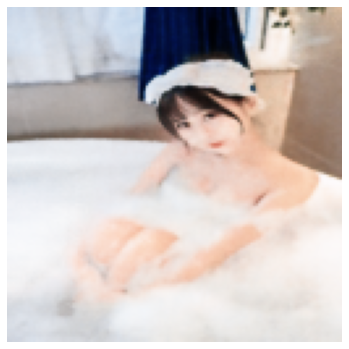

Step: 1100 | Loss: 0.00017425991245545447


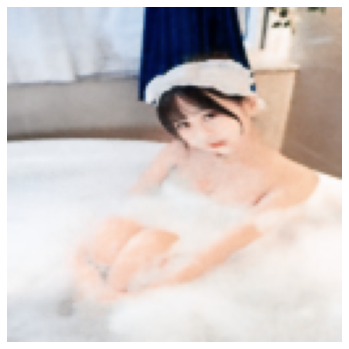

Step: 1150 | Loss: 0.0001721193257253617


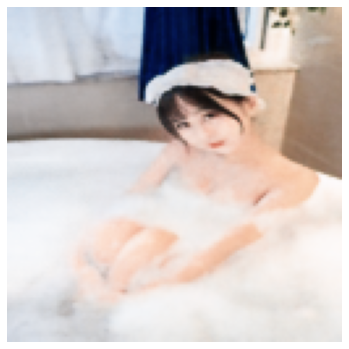

Step: 1200 | Loss: 0.00015084719052538276


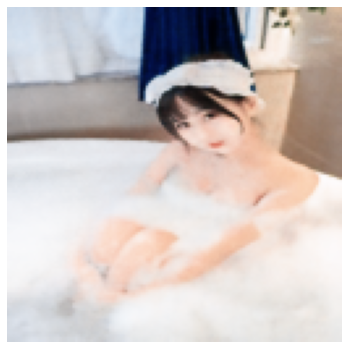

Step: 1250 | Loss: 0.00014144582382868975


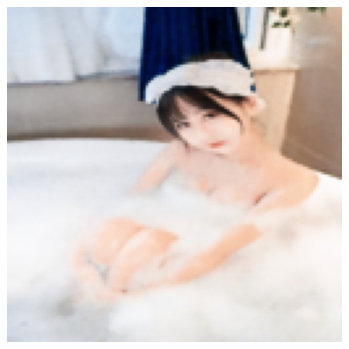

Step: 1300 | Loss: 0.0001572032633703202


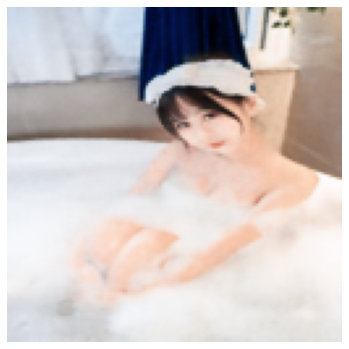

Step: 1350 | Loss: 0.0001234844676218927


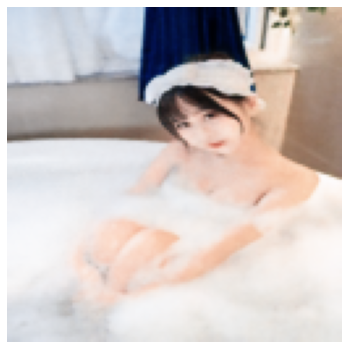

Step: 1400 | Loss: 0.00013646911247633398


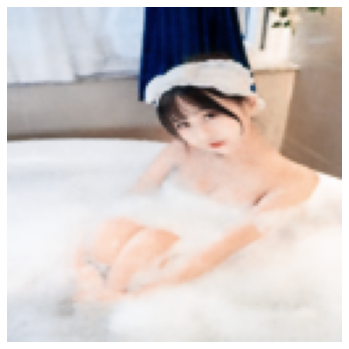

Step: 1450 | Loss: 0.00016779228462837636


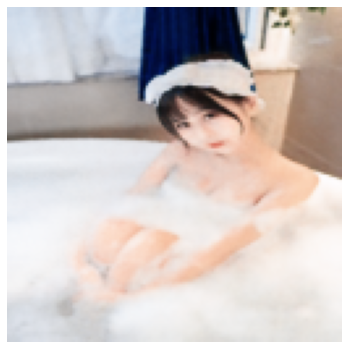

Step: 1500 | Loss: 0.00011755997547879815


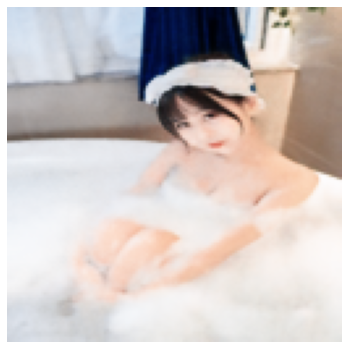

Step: 1550 | Loss: 0.00011470438039395958


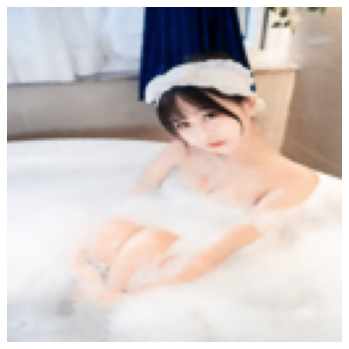

Step: 1600 | Loss: 0.00012201015488244593


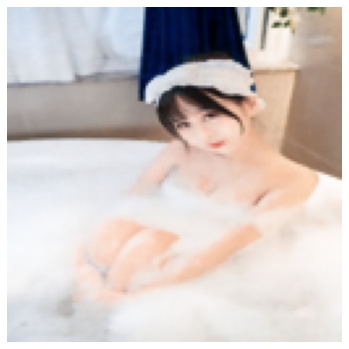

Step: 1650 | Loss: 0.00010774222755571827


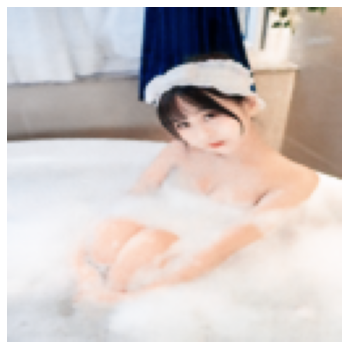

Step: 1700 | Loss: 0.00011888111475855112


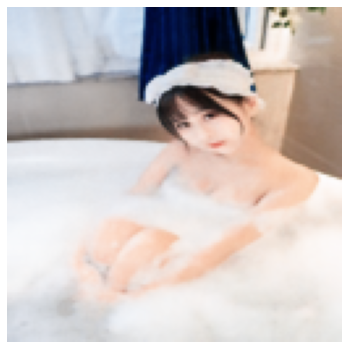

Step: 1750 | Loss: 0.00010656366794137284


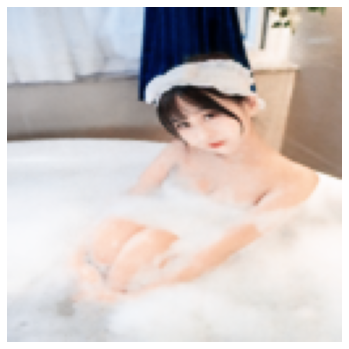

Step: 1800 | Loss: 9.58937598625198e-05


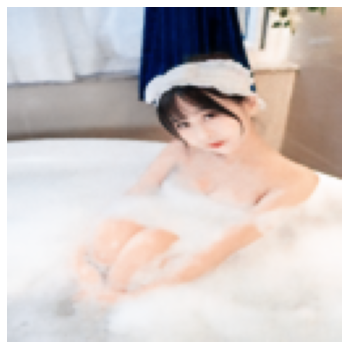

Step: 1850 | Loss: 9.350946493213996e-05


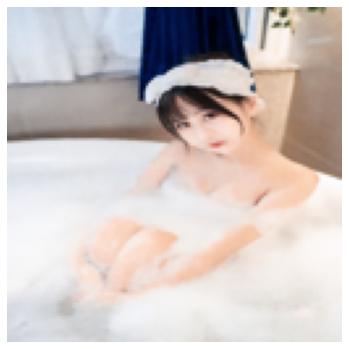

Step: 1900 | Loss: 8.652574615553021e-05


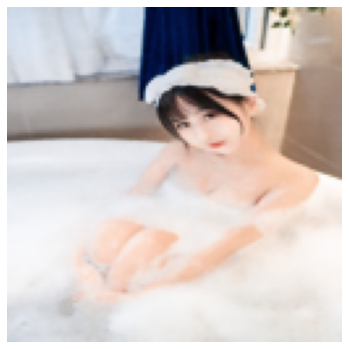

Step: 1950 | Loss: 9.048728679772466e-05


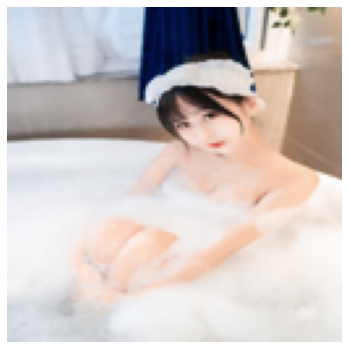

Step: 2000 | Loss: 8.108577458187938e-05


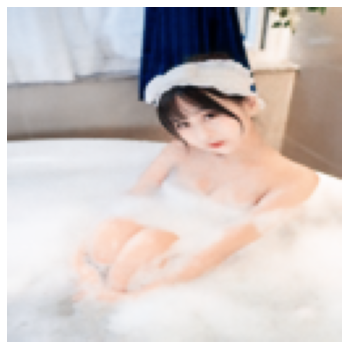

Step: 2050 | Loss: 8.905642607714981e-05


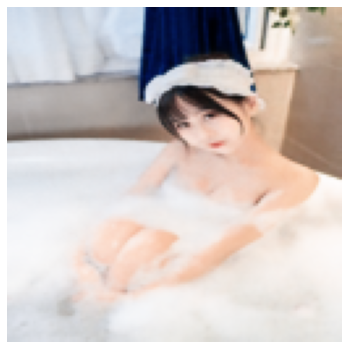

Step: 2100 | Loss: 0.00010117744386661798


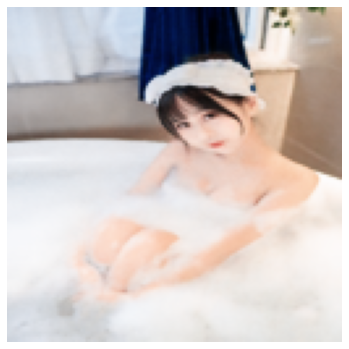

Step: 2150 | Loss: 7.200614345492795e-05


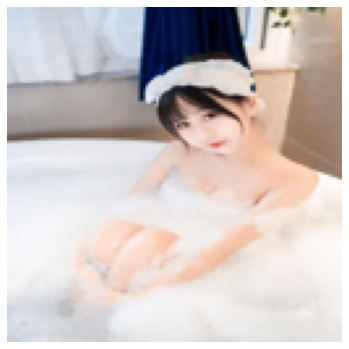

Step: 2200 | Loss: 6.796517118345946e-05


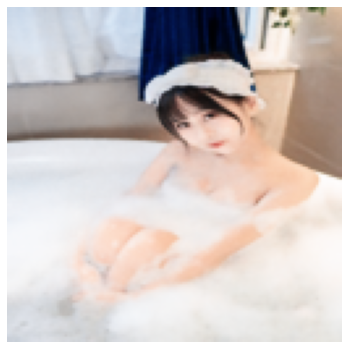

Step: 2250 | Loss: 7.173194899223745e-05


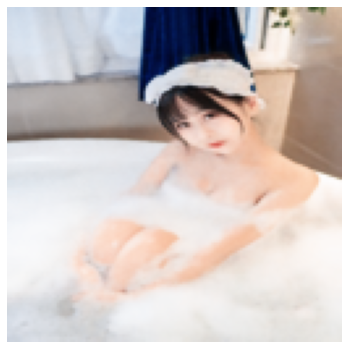

Step: 2300 | Loss: 6.47666965960525e-05


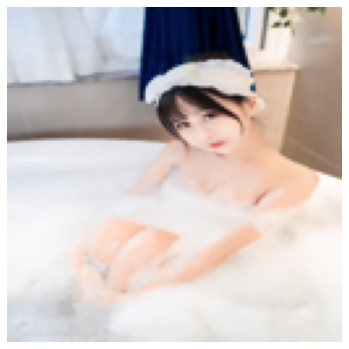

Step: 2350 | Loss: 7.600383105454966e-05


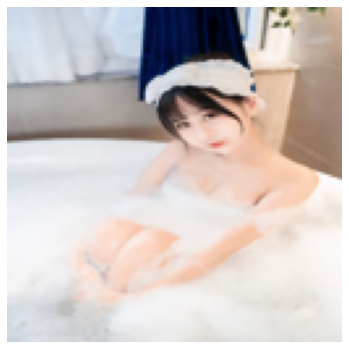

Step: 2400 | Loss: 7.071781874401495e-05


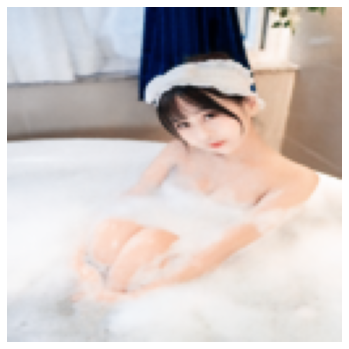

Step: 2450 | Loss: 6.388188194250688e-05


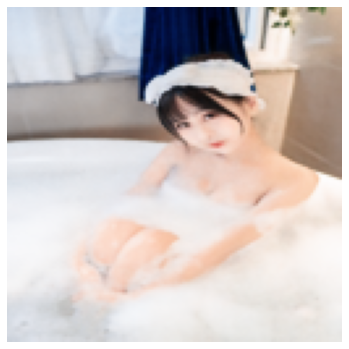

Step: 2500 | Loss: 7.28271552361548e-05


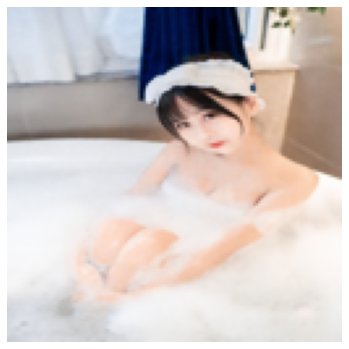

Step: 2550 | Loss: 6.683094397885725e-05


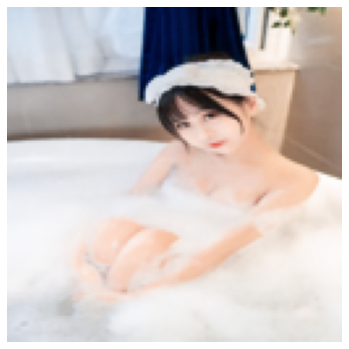

Step: 2600 | Loss: 6.230084545677528e-05


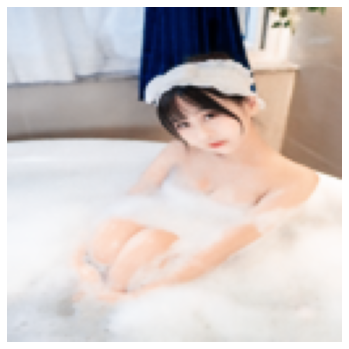

Step: 2650 | Loss: 6.221499643288553e-05


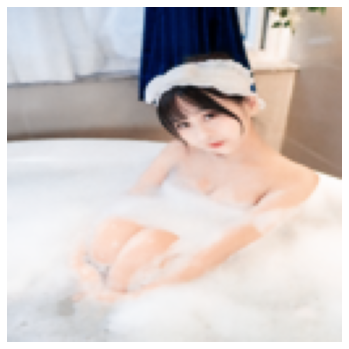

Step: 2700 | Loss: 5.951407001703046e-05


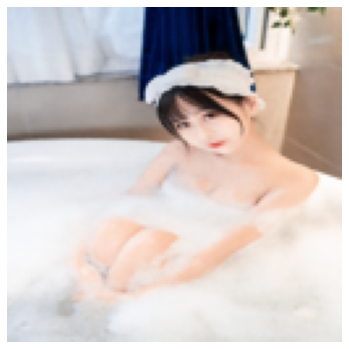

Step: 2750 | Loss: 5.908227103645913e-05


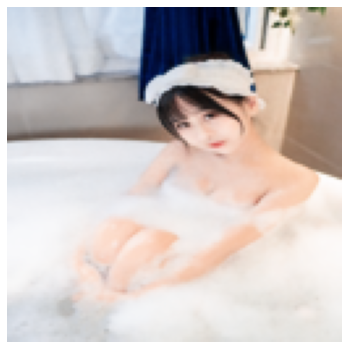

Step: 2800 | Loss: 5.324813537299633e-05


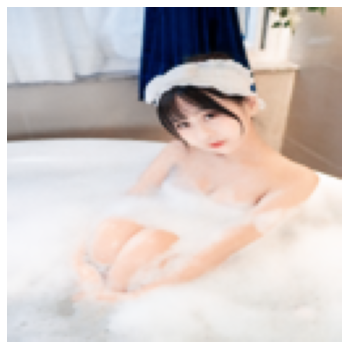

Step: 2850 | Loss: 6.35910764685832e-05


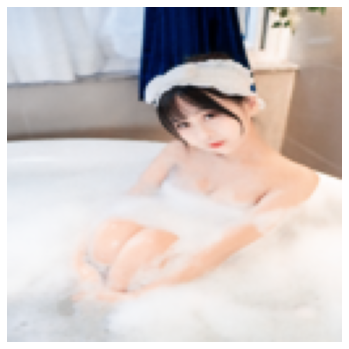

Step: 2900 | Loss: 5.2238214266253635e-05


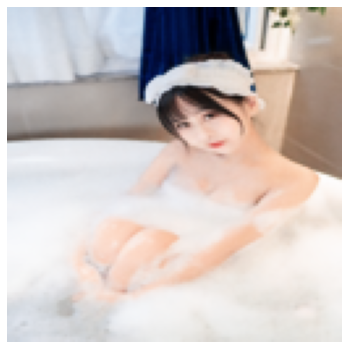

Step: 2950 | Loss: 6.139709876151755e-05


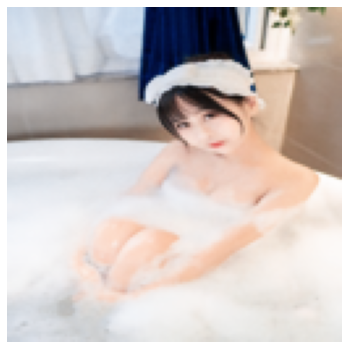

Step: 3000 | Loss: 4.906381946057081e-05


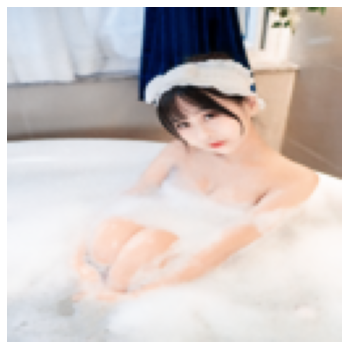

Step: 3050 | Loss: 4.467098551685922e-05


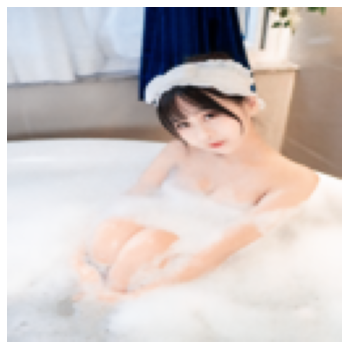

Step: 3100 | Loss: 4.7193258069455624e-05


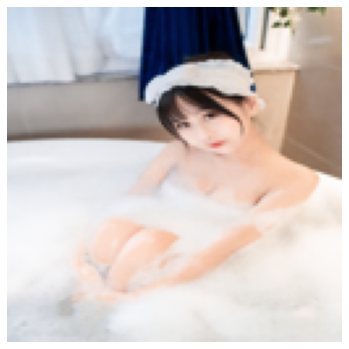

Step: 3150 | Loss: 5.900629184907302e-05


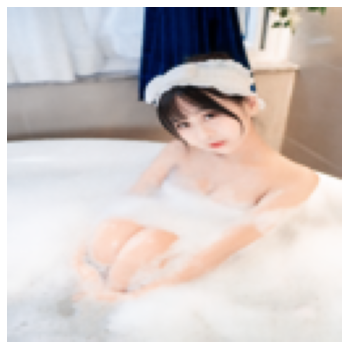

Step: 3200 | Loss: 4.2969062633346766e-05


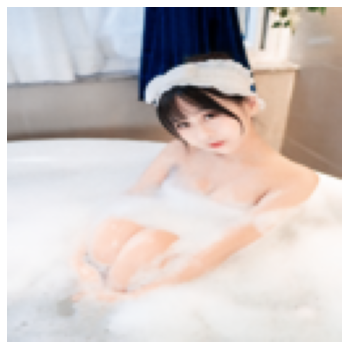

Step: 3250 | Loss: 4.5893408241681755e-05


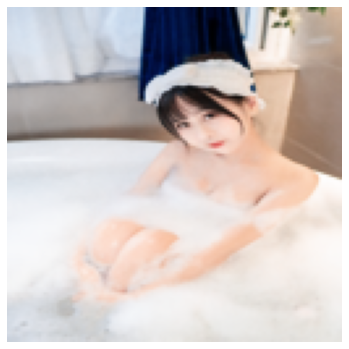

Step: 3300 | Loss: 4.21078220824711e-05


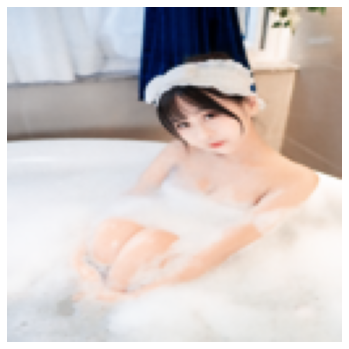

Step: 3350 | Loss: 4.117115895496681e-05


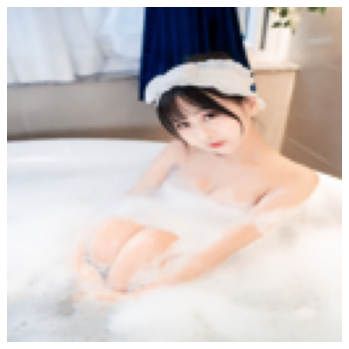

Step: 3400 | Loss: 4.653309588320553e-05


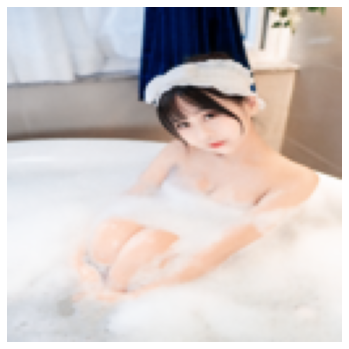

Step: 3450 | Loss: 4.300515502109192e-05


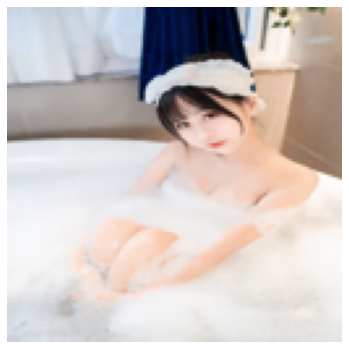

Step: 3500 | Loss: 4.3970961996819824e-05


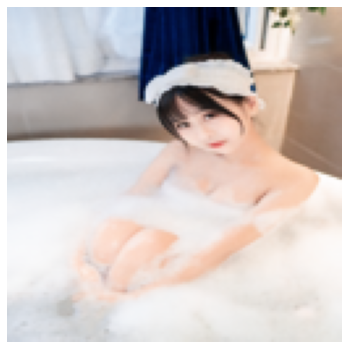

Step: 3550 | Loss: 3.804174775723368e-05


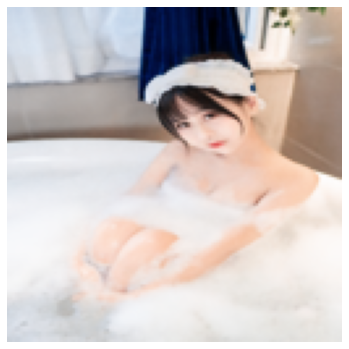

Step: 3600 | Loss: 3.827025284408592e-05


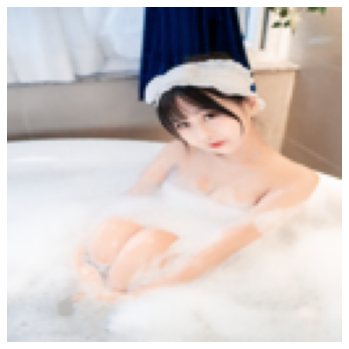

Step: 3650 | Loss: 4.164158599451184e-05


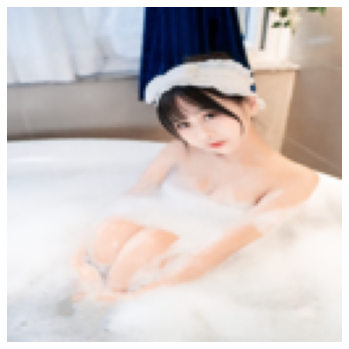

Step: 3700 | Loss: 4.0658138459548354e-05


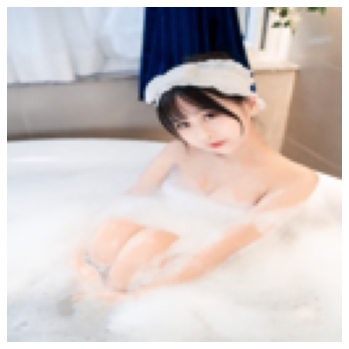

Step: 3750 | Loss: 3.839826604234986e-05


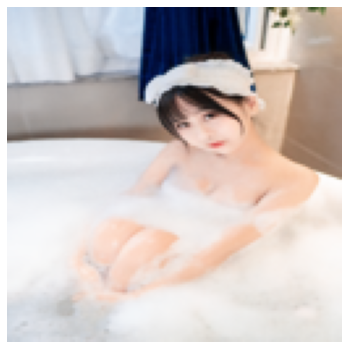

Step: 3800 | Loss: 4.1617779061198235e-05


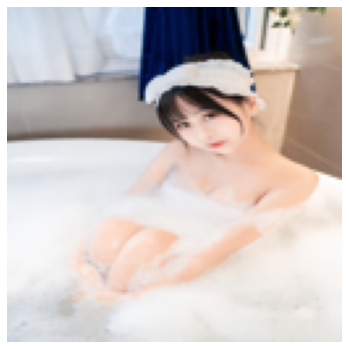

Step: 3850 | Loss: 3.378166729817167e-05


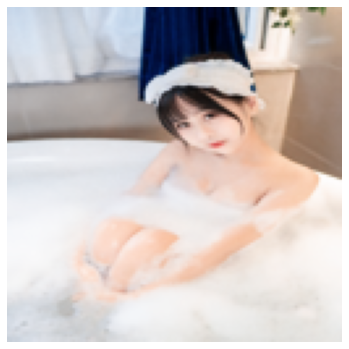

Step: 3900 | Loss: 4.236187305650674e-05


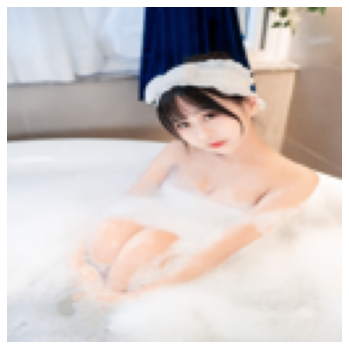

Step: 3950 | Loss: 4.1238607082050294e-05


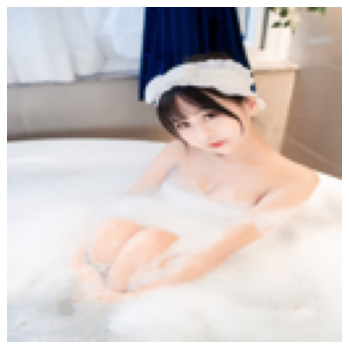

Step: 4000 | Loss: 4.251121572451666e-05


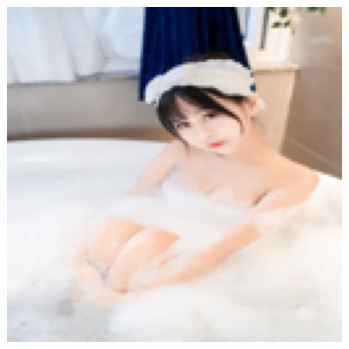

Step: 4050 | Loss: 3.702679168782197e-05


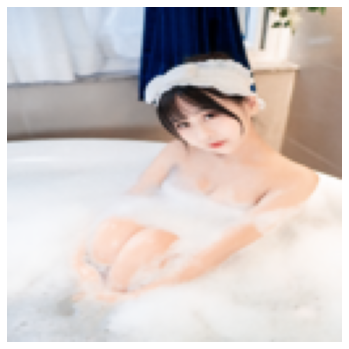

Step: 4100 | Loss: 3.503453262965195e-05


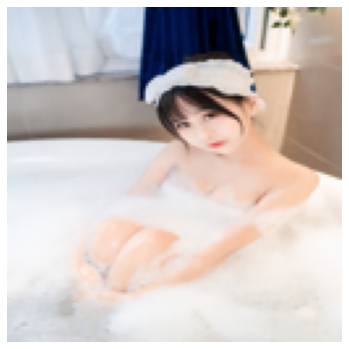

Step: 4150 | Loss: 3.443827517912723e-05


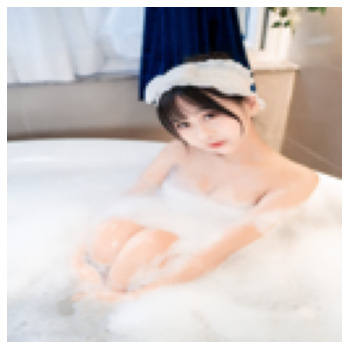

Step: 4200 | Loss: 3.6238277971278876e-05


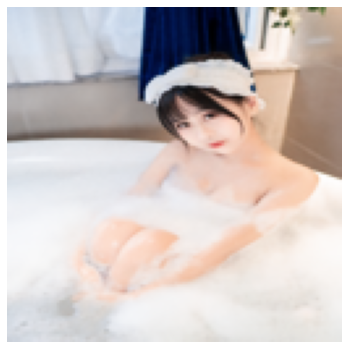

Step: 4250 | Loss: 3.0098308343440294e-05


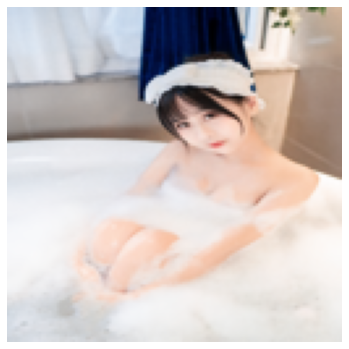

Step: 4300 | Loss: 3.0293957024696283e-05


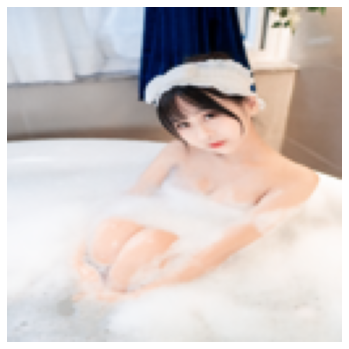

Step: 4350 | Loss: 4.0863083995645866e-05


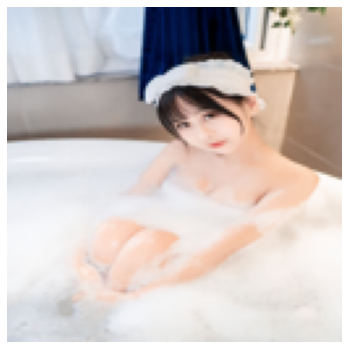

Step: 4400 | Loss: 2.92742442979943e-05


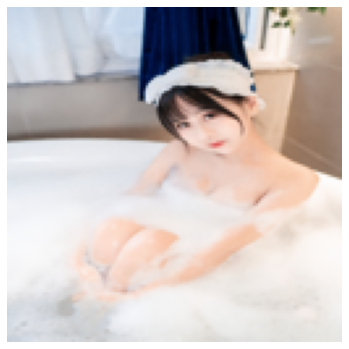

Step: 4450 | Loss: 3.7943980714771897e-05


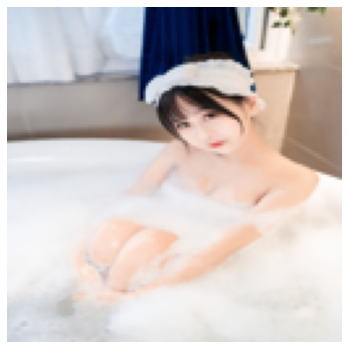

Step: 4500 | Loss: 5.510578557732515e-05


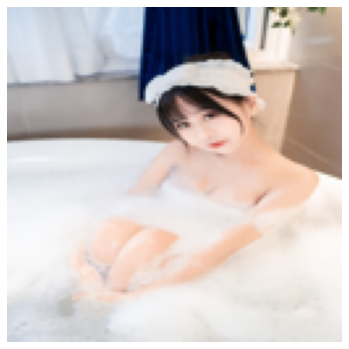

Step: 4550 | Loss: 3.43547944794409e-05


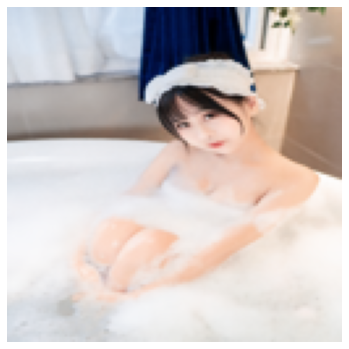

Step: 4600 | Loss: 3.1472671253141016e-05


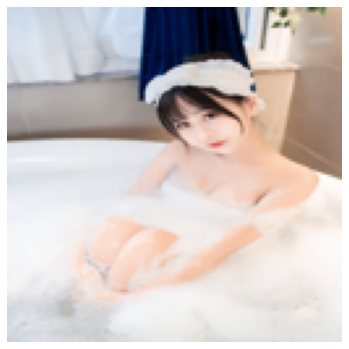

Step: 4650 | Loss: 2.587729068181943e-05


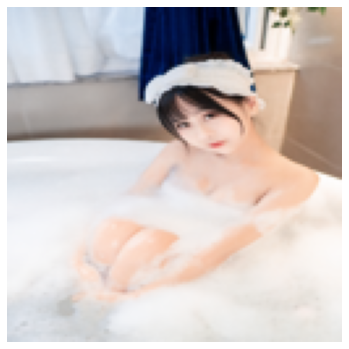

Step: 4700 | Loss: 3.396322063053958e-05


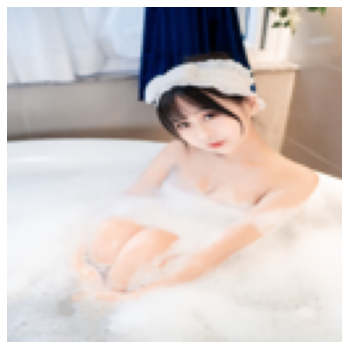

Step: 4750 | Loss: 2.8215834390721284e-05


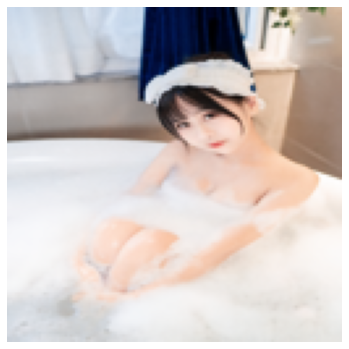

Step: 4800 | Loss: 2.8237776859896258e-05


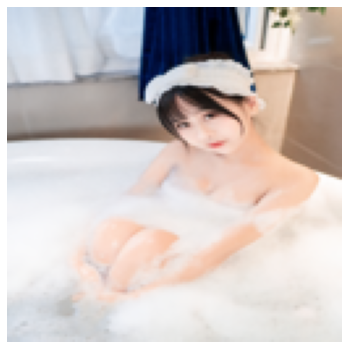

Step: 4850 | Loss: 2.7367123038857244e-05


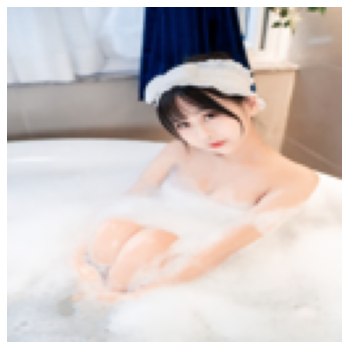

Step: 4900 | Loss: 3.8206748286029324e-05


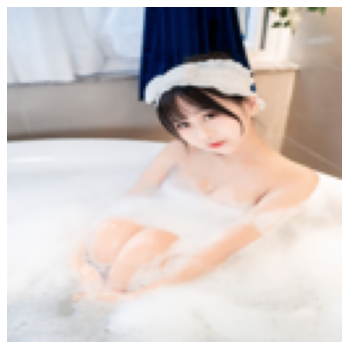

Step: 4950 | Loss: 2.49050553975394e-05


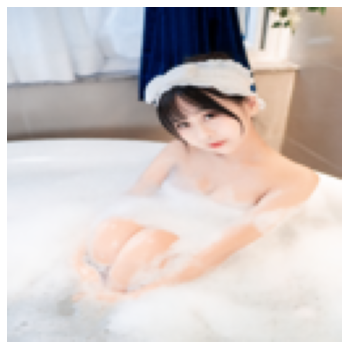

Step: 5000 | Loss: 2.268586467835121e-05


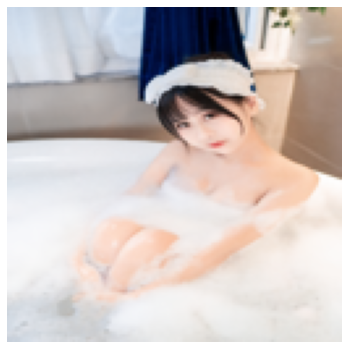

Step: 5050 | Loss: 2.248795317427721e-05


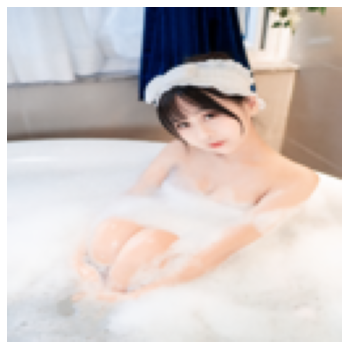

Step: 5100 | Loss: 2.554377533670049e-05


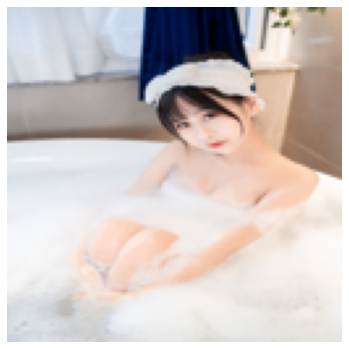

Step: 5150 | Loss: 2.4928549464675598e-05


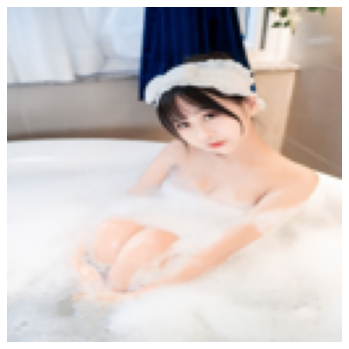

Step: 5200 | Loss: 2.37224085140042e-05


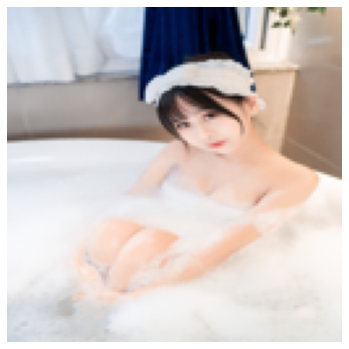

Step: 5250 | Loss: 2.9807371902279556e-05


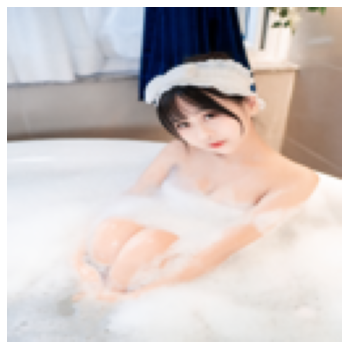

Step: 5300 | Loss: 2.443596713419538e-05


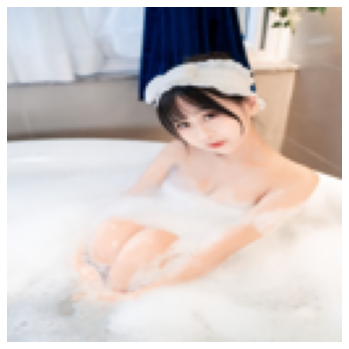

Step: 5350 | Loss: 3.550520341377705e-05


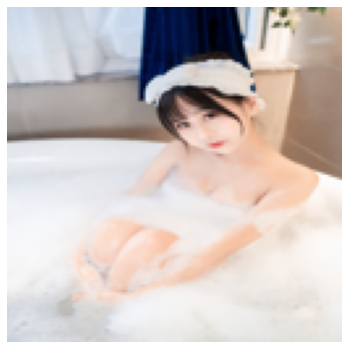

Step: 5400 | Loss: 2.1323290638974868e-05


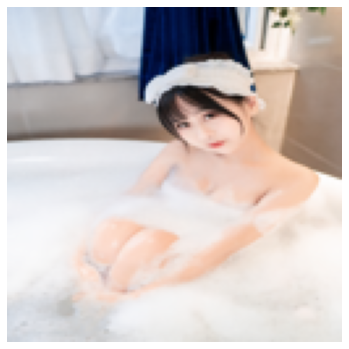

Step: 5450 | Loss: 2.4248660338344052e-05


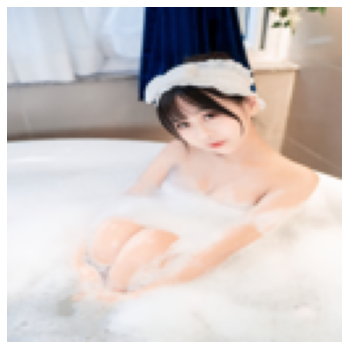

Step: 5500 | Loss: 3.476058191154152e-05


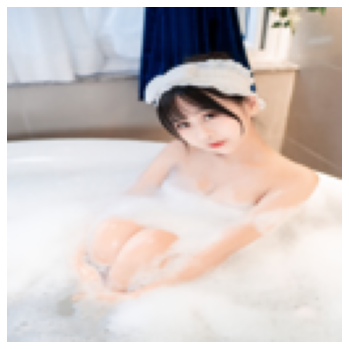

Step: 5550 | Loss: 2.268774369440507e-05


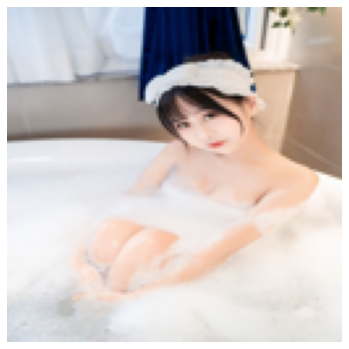

Step: 5600 | Loss: 1.9618793885456398e-05


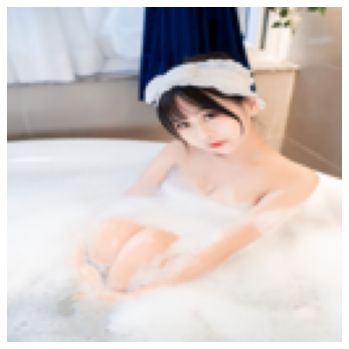

Step: 5650 | Loss: 2.275179940625094e-05


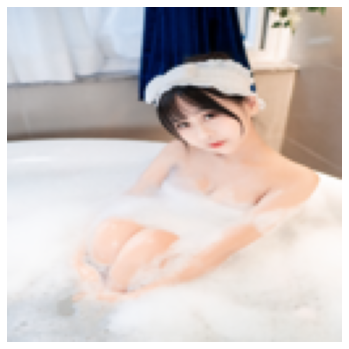

Step: 5700 | Loss: 3.6745055695064366e-05


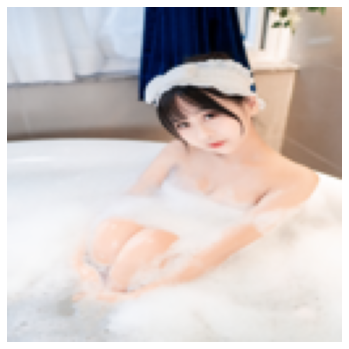

Step: 5750 | Loss: 1.9284805603092536e-05


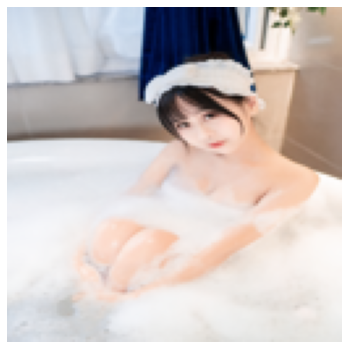

Step: 5800 | Loss: 2.9701281164307147e-05


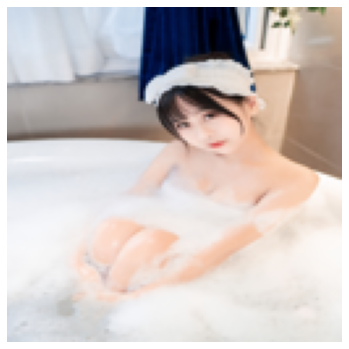

Step: 5850 | Loss: 2.058923928416334e-05


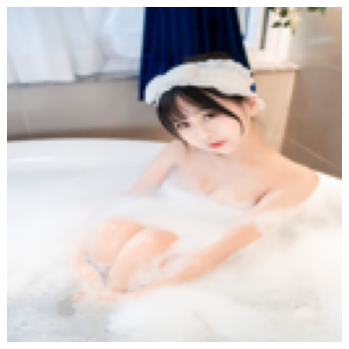

Step: 5900 | Loss: 2.1573992853518575e-05


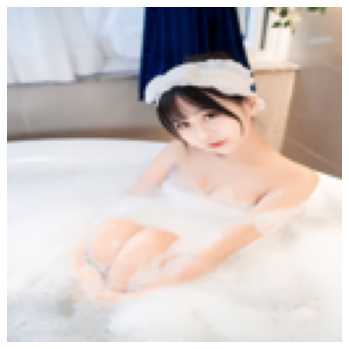

Step: 5950 | Loss: 1.867449827841483e-05


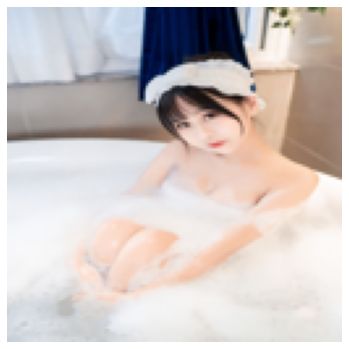

Step: 6000 | Loss: 2.5126653781626374e-05


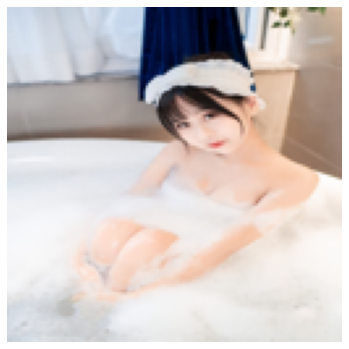

Step: 6050 | Loss: 2.336897887289524e-05


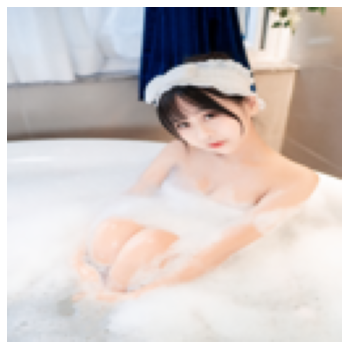

Step: 6100 | Loss: 1.8216625903733075e-05


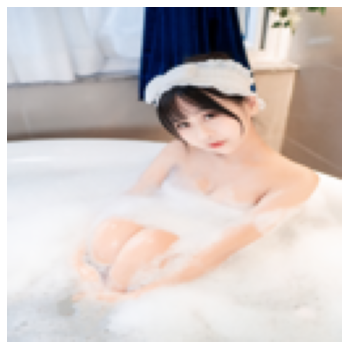

Step: 6150 | Loss: 1.8140210158890113e-05


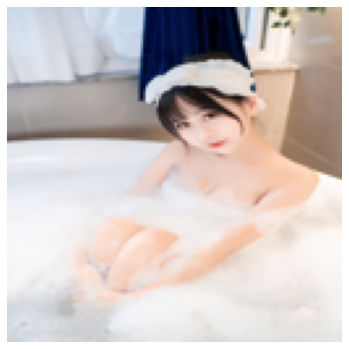

Step: 6200 | Loss: 1.9414339476497844e-05


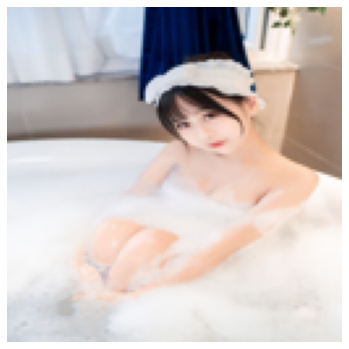

Step: 6250 | Loss: 2.9307975637493655e-05


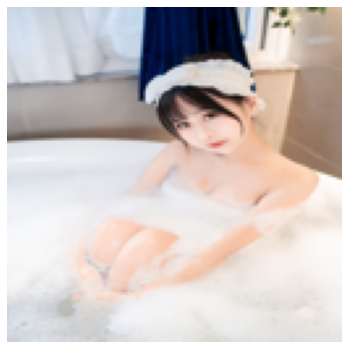

Step: 6300 | Loss: 1.9179402443114668e-05


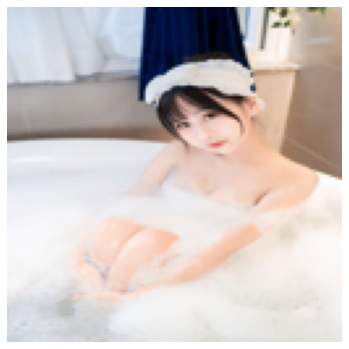

Step: 6350 | Loss: 2.3510816390626132e-05


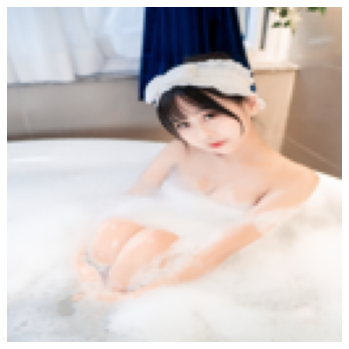

Step: 6400 | Loss: 2.003353256441187e-05


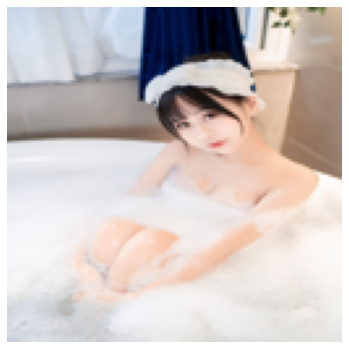

Step: 6450 | Loss: 1.66738209372852e-05


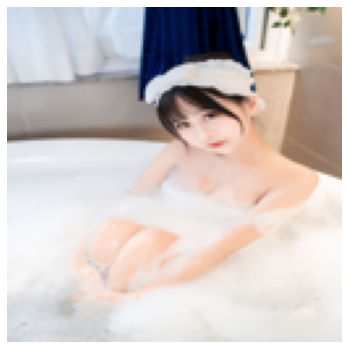

Step: 6500 | Loss: 1.978483487619087e-05


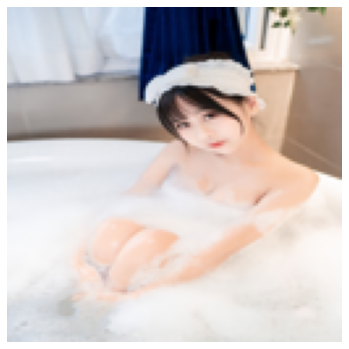

Step: 6550 | Loss: 1.4492614354821853e-05


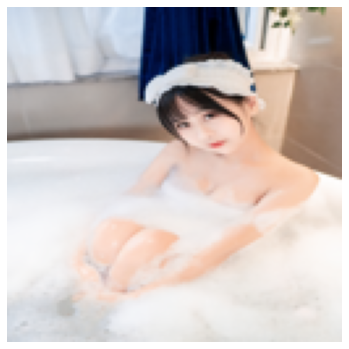

Step: 6600 | Loss: 2.3125545340008102e-05


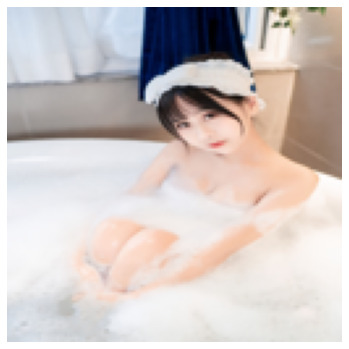

Step: 6650 | Loss: 1.5303505279007368e-05


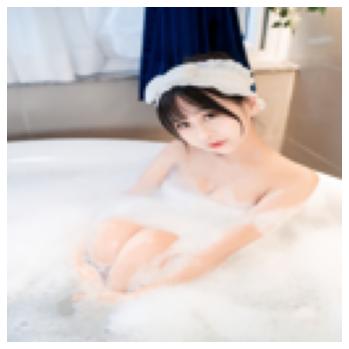

Step: 6700 | Loss: 2.0119110558880493e-05


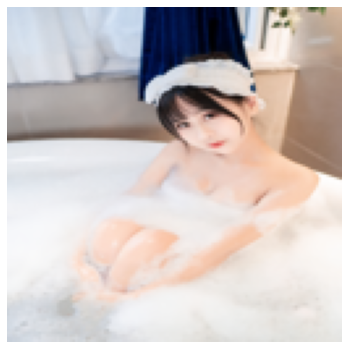

Step: 6750 | Loss: 2.2017831724951975e-05


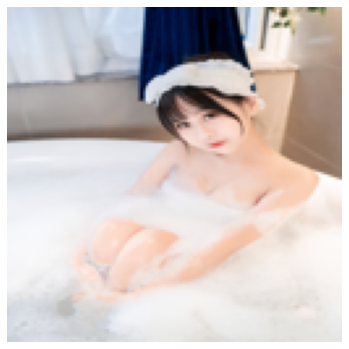

Step: 6800 | Loss: 1.7561316781211644e-05


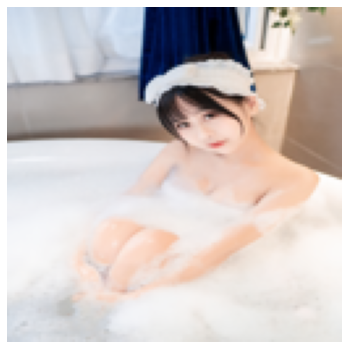

Step: 6850 | Loss: 1.9664064893731847e-05


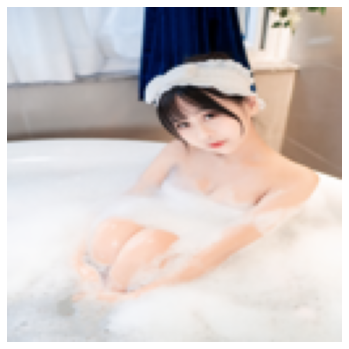

Step: 6900 | Loss: 1.6418569430243224e-05


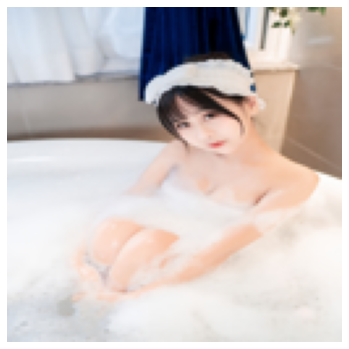

Step: 6950 | Loss: 1.8941407688544132e-05


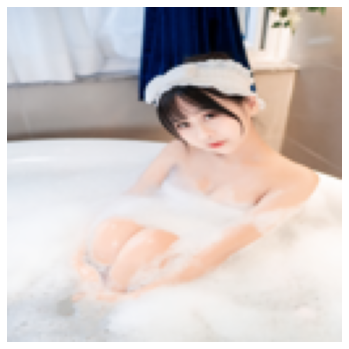

Step: 7000 | Loss: 1.4623557035520207e-05


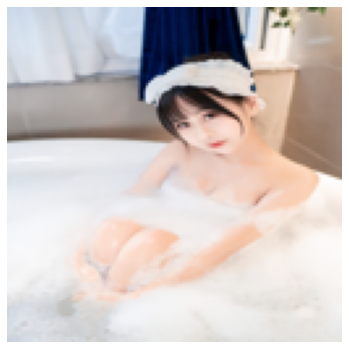

Step: 7050 | Loss: 1.6228061213041656e-05


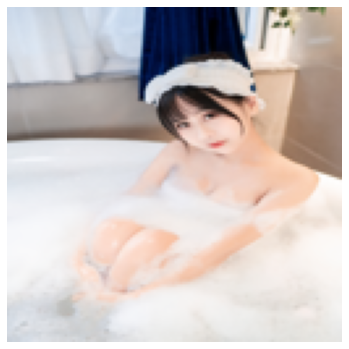

Step: 7100 | Loss: 1.364413219562266e-05


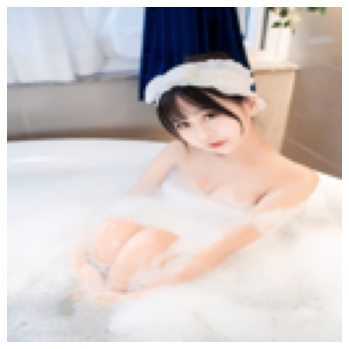

Step: 7150 | Loss: 2.0367464458104223e-05


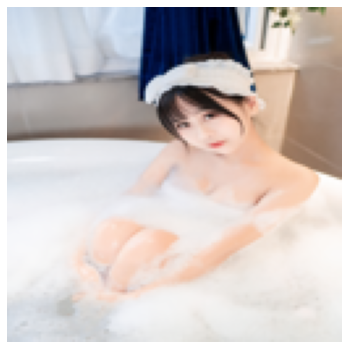

Step: 7200 | Loss: 1.572351720824372e-05


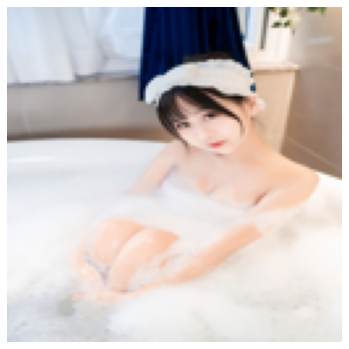

Step: 7250 | Loss: 2.6728737793746404e-05


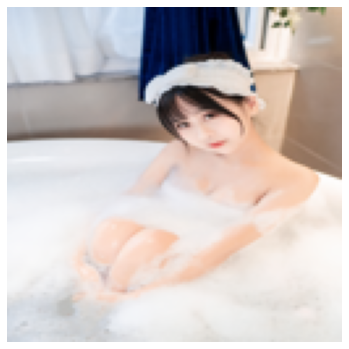

Step: 7300 | Loss: 1.4396839105756953e-05


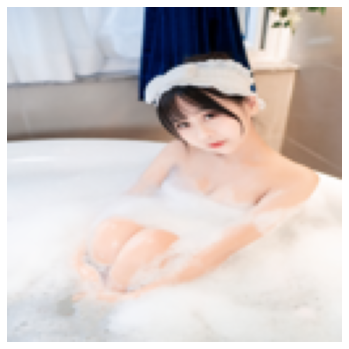

Step: 7350 | Loss: 1.3312294868228491e-05


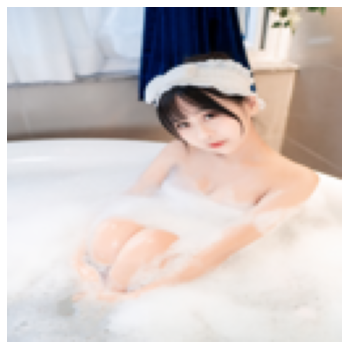

Step: 7400 | Loss: 2.350399154238403e-05


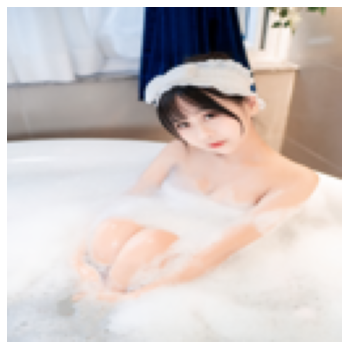

Step: 7450 | Loss: 1.3310654139786493e-05


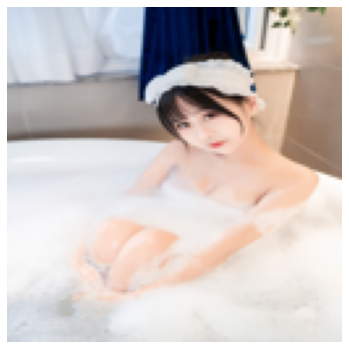

Step: 7500 | Loss: 1.929472273332067e-05


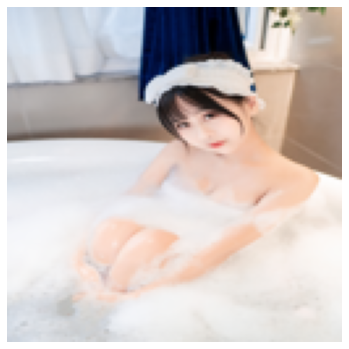

Step: 7550 | Loss: 1.5309438822441734e-05


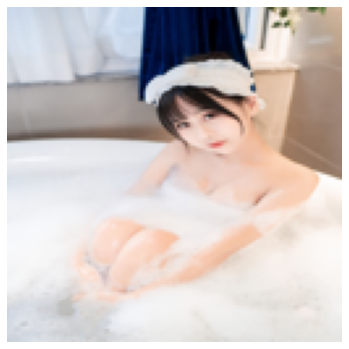

Step: 7600 | Loss: 1.1237420949328225e-05


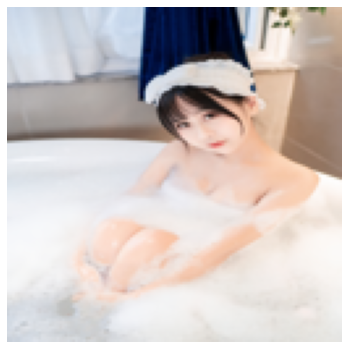

Step: 7650 | Loss: 1.2055219485773705e-05


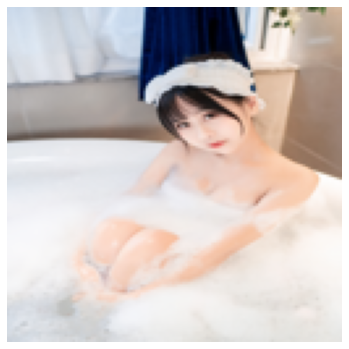

Step: 7700 | Loss: 2.3178577976068482e-05


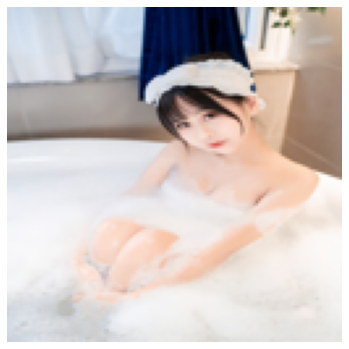

Step: 7750 | Loss: 1.3377646610024385e-05


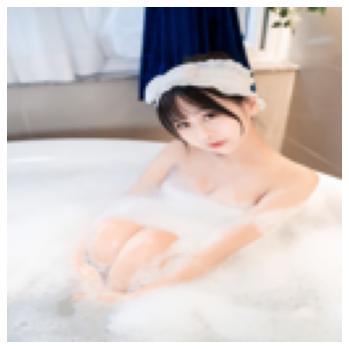

Step: 7800 | Loss: 1.40880938488408e-05


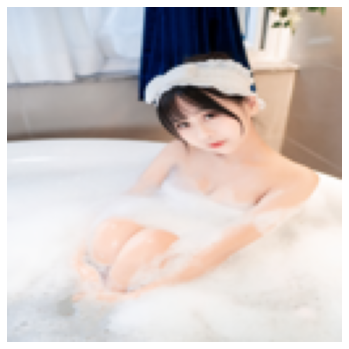

Step: 7850 | Loss: 1.529955625301227e-05


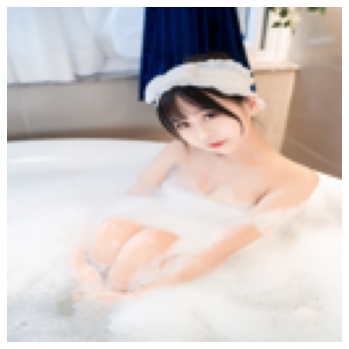

Step: 7900 | Loss: 1.18305788419093e-05


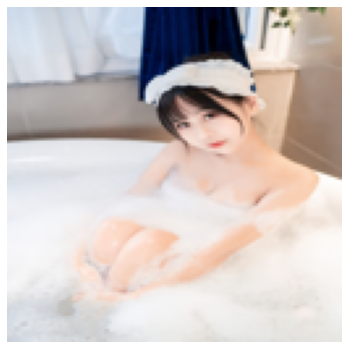

Step: 7950 | Loss: 1.6009418686735444e-05


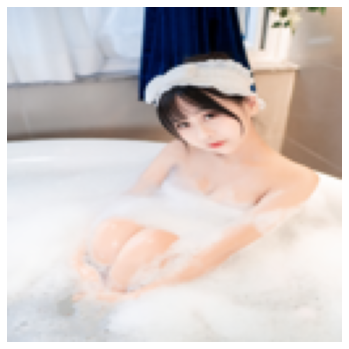

Step: 8000 | Loss: 1.255939423572272e-05


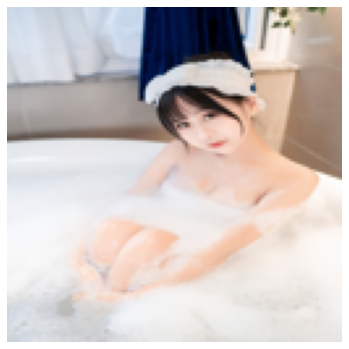

Step: 8050 | Loss: 1.3370356100494973e-05


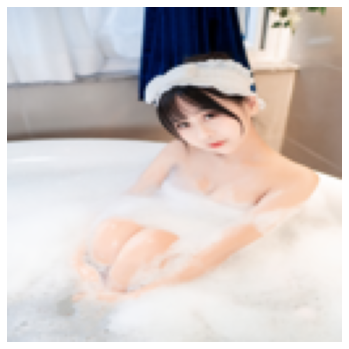

Step: 8100 | Loss: 1.1108342732768506e-05


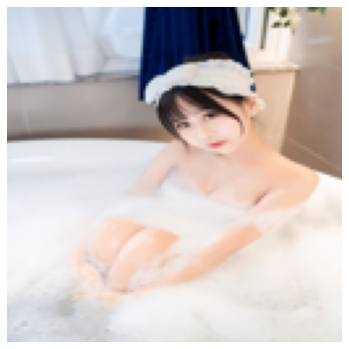

Step: 8150 | Loss: 1.5494137187488377e-05


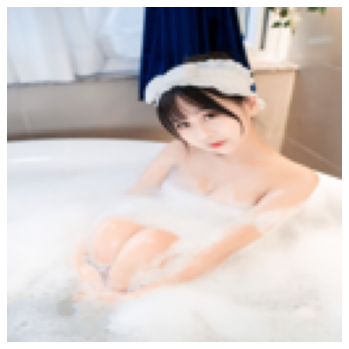

Step: 8200 | Loss: 1.1255112440267112e-05


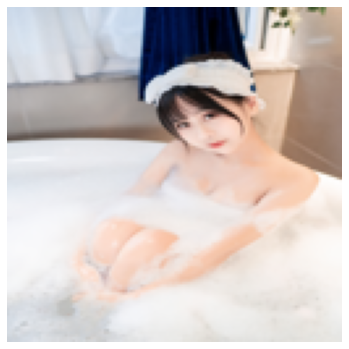

Step: 8250 | Loss: 1.127854466176359e-05


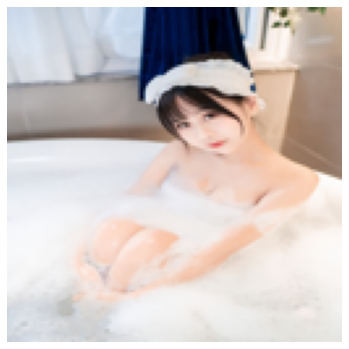

Step: 8300 | Loss: 1.273507223231718e-05


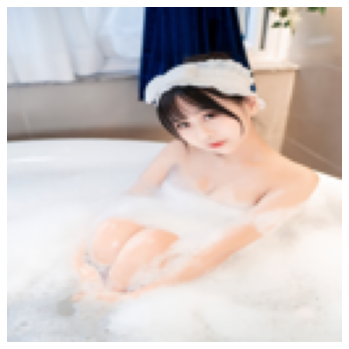

Step: 8350 | Loss: 1.3549051800509915e-05


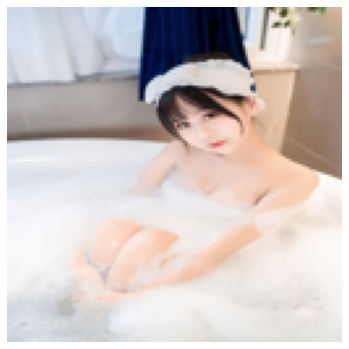

Step: 8400 | Loss: 1.6398331354139373e-05


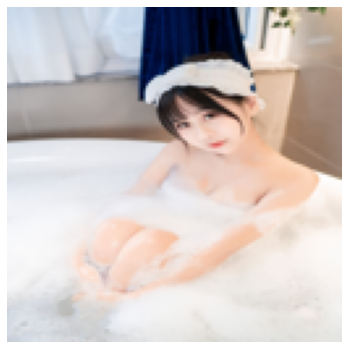

Step: 8450 | Loss: 1.0090899195347447e-05


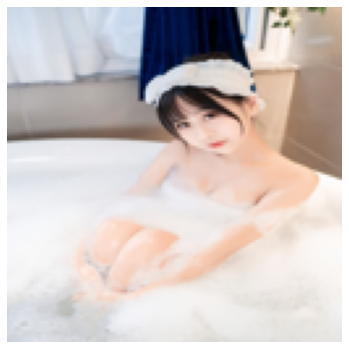

Step: 8500 | Loss: 1.2413332115102094e-05


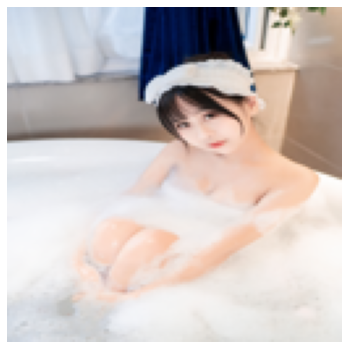

Step: 8550 | Loss: 9.654758287069853e-06


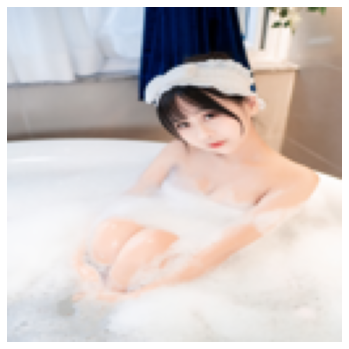

Step: 8600 | Loss: 1.3602631952380762e-05


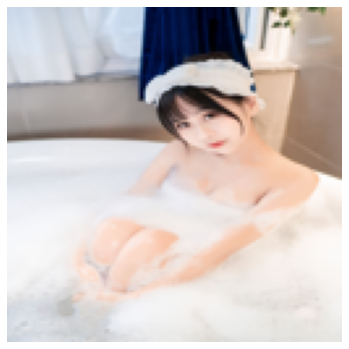

Step: 8650 | Loss: 9.122526535065845e-06


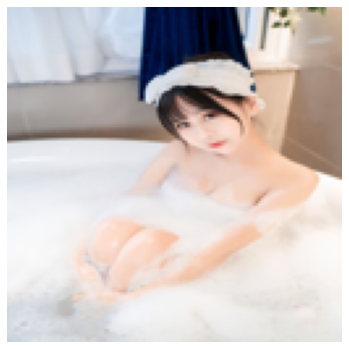

Step: 8700 | Loss: 1.016964961308986e-05


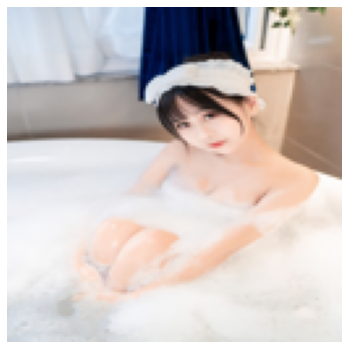

Step: 8750 | Loss: 1.4408807146537583e-05


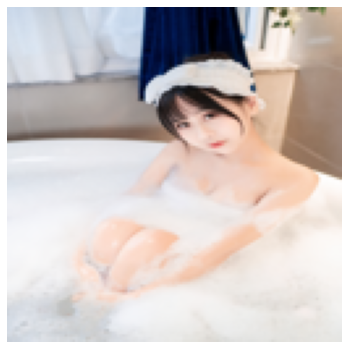

Step: 8800 | Loss: 1.58265665959334e-05


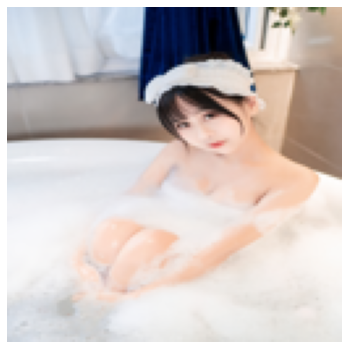

Step: 8850 | Loss: 8.174521099135745e-06


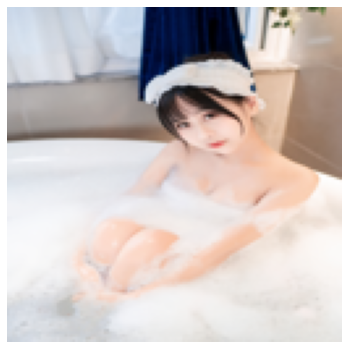

Step: 8900 | Loss: 1.2715193406620529e-05


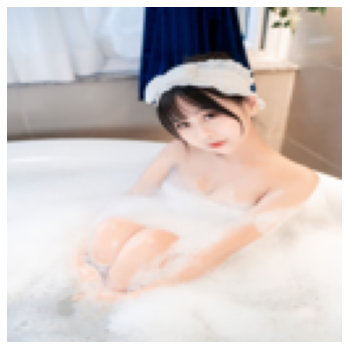

Step: 8950 | Loss: 1.1104626537417062e-05


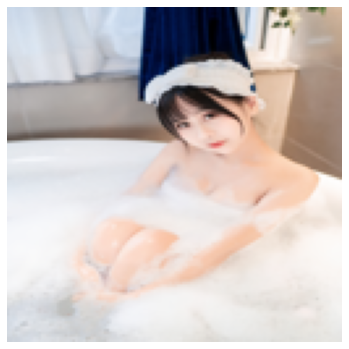

Step: 9000 | Loss: 9.683881216915324e-06


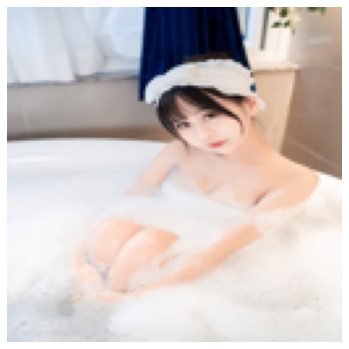

Step: 9050 | Loss: 1.2300911294005346e-05


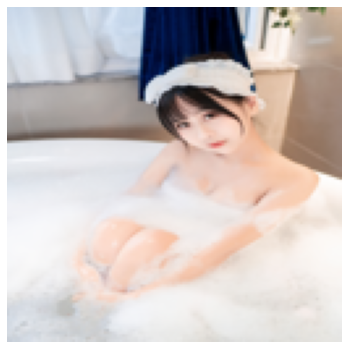

Step: 9100 | Loss: 1.2328247066761833e-05


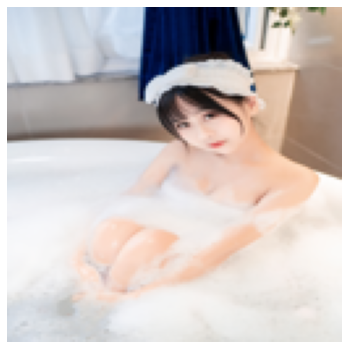

Step: 9150 | Loss: 1.2394157238304615e-05


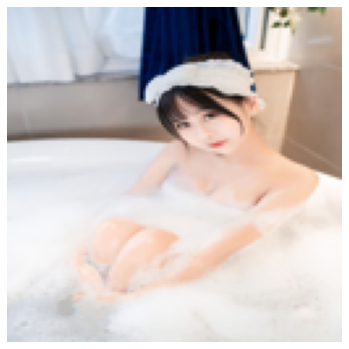

Step: 9200 | Loss: 1.412067922501592e-05


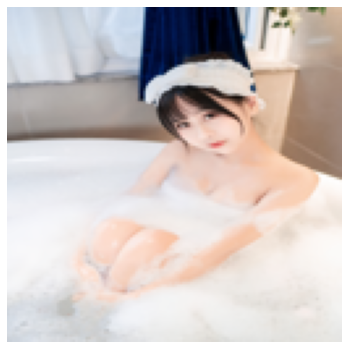

Step: 9250 | Loss: 1.3817926628689747e-05


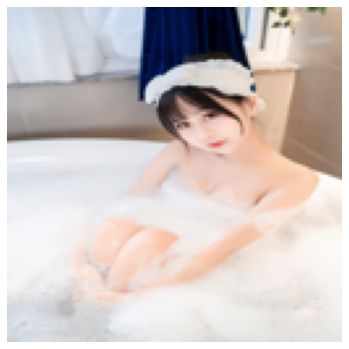

Step: 9300 | Loss: 1.277257251786068e-05


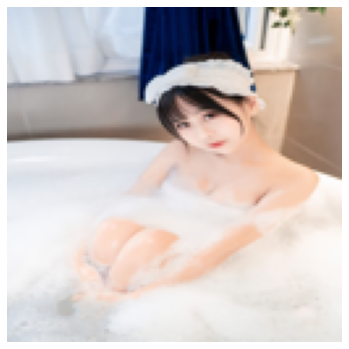

Step: 9350 | Loss: 8.69870746100787e-06


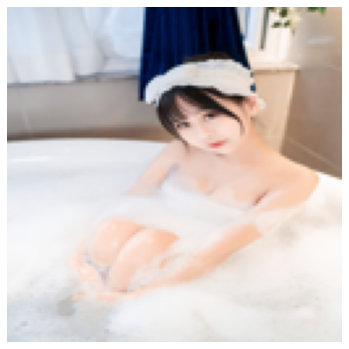

Step: 9400 | Loss: 1.1758334949263372e-05


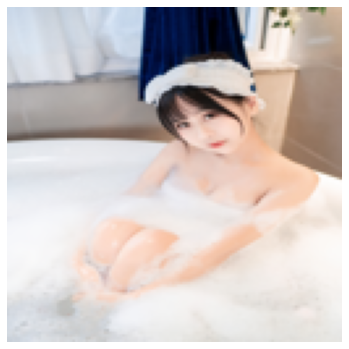

Step: 9450 | Loss: 1.1702696610882413e-05


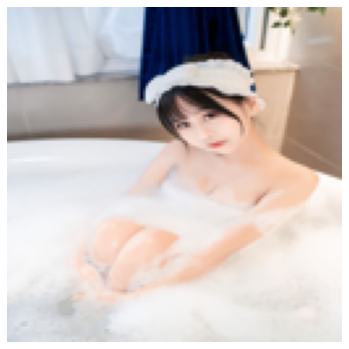

Step: 9500 | Loss: 1.3623403901874553e-05


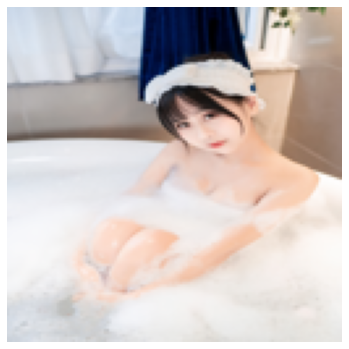

Step: 9550 | Loss: 8.513781722285785e-06


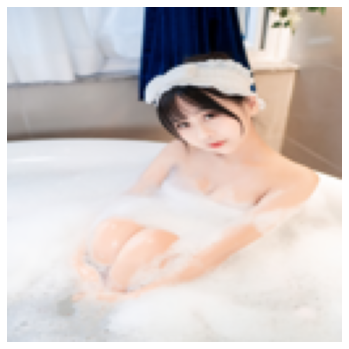

Step: 9600 | Loss: 9.714735824672971e-06


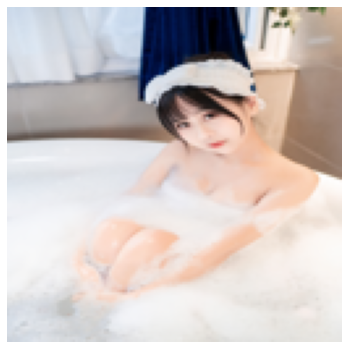

Step: 9650 | Loss: 2.1126623323652893e-05


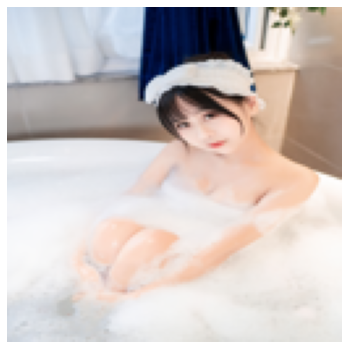

Step: 9700 | Loss: 1.1113696018583141e-05


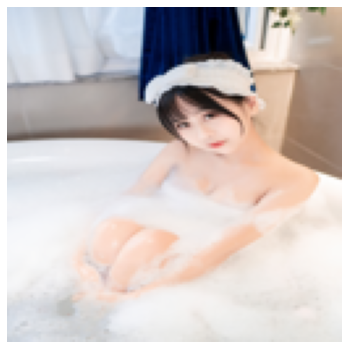

Step: 9750 | Loss: 7.718533197476063e-06


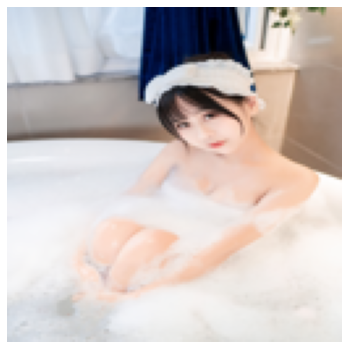

Step: 9800 | Loss: 1.060354225046467e-05


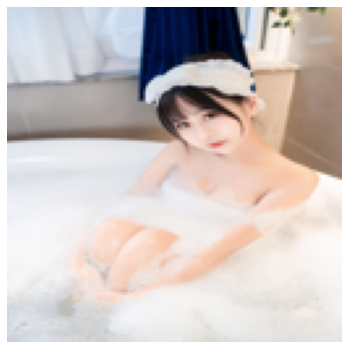

Step: 9850 | Loss: 8.140226782415994e-06


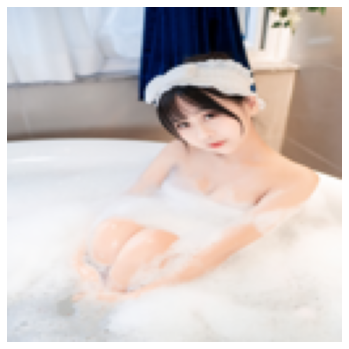

Step: 9900 | Loss: 6.438356194848893e-06


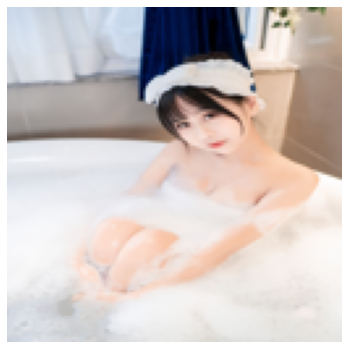

Step: 9950 | Loss: 6.506724275823217e-06


In [8]:
if os.path.isdir('progress'):
    rmtree('progress')
os.mkdir('progress')

for step in range(TRAINING_STEPS):
    optimizer.zero_grad()
    generator_input = generator_input_saved

    if REG_NOISE > 0:
        generator_input = generator_input_saved + (noise.normal_() * REG_NOISE)
        
    output = generator(generator_input)
   
    loss = objective(output * watermark_var, watermarked_var)
    loss.backward()
        
    if step % SHOW_STEP == 0:
        output_image = torch_to_np_array(output)
        save_image(output_image, step)
        visualize_sample(output_image, nrow = 1, size_factor = 5)
        print(f'Step: {step} | Loss: {loss.item()}')
        
    optimizer.step()